In [1]:
import pandas, numpy, glob, re
from pylab import *

def read_zipcode_ascii_boundary(filestem):
    '''
    Reads polygon data from an ASCII boundary file.
    Returns a dictionary with polygon IDs for keys. The value for each
    key is another dictionary with three keys:
    'name' - the name of the polygon
    'polygon' - list of (longitude, latitude) pairs defining the main 
    polygon boundary 
    'exclusions' - list of lists of (lon, lat) pairs for any exclusions in
    the main polygon
    '''
    metadata_file = filestem + 'a.dat'
    data_file = filestem + '.dat'
    prefix = filestem.split('/')[-1]
    # Read metadata
    lines = [line.strip().strip('"') for line in open(metadata_file)]
    polygon_ids = lines[::6]
    polygon_names = lines[2::6]
    polygon_data = {}
    for polygon_id, polygon_name in zip(polygon_ids, polygon_names):
        # Initialize entry with name of polygon.
        # In this case the polygon_name will be the 5-digit ZIP code.
        polygon_data[prefix + '_' + polygon_id] = {'name': polygon_name}
    del polygon_data[prefix + '_' + '0']
    # Read lon and lat.
    f = open(data_file)
    min_lon = numpy.inf
    max_lon = -numpy.inf
    min_lat = numpy.inf
    max_lat = -numpy.inf
    for line in f:
        fields = line.split()
        if len(fields) == 3:
            # Initialize new polygon
            polygon_id = prefix + '_' + fields[0]
            polygon_data[polygon_id]['polygon'] = []
            polygon_data[polygon_id]['exclusions'] = []
        elif len(fields) == 1:
            # -99999 denotes the start of a new sub-polygon
            if fields[0] == '-99999':
                polygon_data[polygon_id]['exclusions'].append([])
        else:
            # Add lon/lat pair to main polygon or exclusion
            lon = float(fields[0])
            lat = float(fields[1])
            if polygon_data[polygon_id]['exclusions']:
                polygon_data[polygon_id]['exclusions'][-1].append((lon, lat))
            else:
                polygon_data[polygon_id]['polygon'].append((lon, lat))
                if lon < min_lon:
                    min_lon = lon
                elif lon > max_lon:
                    max_lon = lon
                if lat < min_lat:
                    min_lat = lat
                elif lat > max_lat:
                    max_lat = lat
    f.close()
    return polygon_data, [min_lon - 0.2, max_lon + 0.2, min_lat - 0.2, max_lat + 0.2] #[numpy.floor(min_lon), numpy.ceil(max_lon), numpy.floor(min_lat), numpy.ceil(max_lat)]

def read_county_ascii_boundary(filestem):
    '''
    Reads polygon data from an ASCII boundary file.
    Returns a dictionary with polygon IDs for keys. The value for each
    key is another dictionary with three keys:
    'name' - the name of the polygon
    'polygon' - list of (longitude, latitude) pairs defining the main 
    polygon boundary 
    'exclusions' - list of lists of (lon, lat) pairs for any exclusions in
    the main polygon
    '''
    metadata_file = filestem + 'a.dat'
    data_file = filestem + '.dat'
    prefix = filestem.split('/')[-1]
    # Read metadata
    lines = [line.strip().strip('"') for line in open(metadata_file)]
    polygon_ids = lines[::7]
    #polygon_names = lines[2::7]
    polygon_names = [prefix.split('_')[0].split('co')[-1] + str(names) for names in lines[2::7]]
    polygon_data = {}
    for polygon_id, polygon_name in zip(polygon_ids, polygon_names):
        # Initialize entry with name of polygon.
        # In this case the polygon_name will be the 5-digit ZIP code.
        polygon_data[prefix + '_' + polygon_id] = {'name': polygon_name}
    del polygon_data[prefix + '_' + '0']
    # Read lon and lat.
    f = open(data_file)
    min_lon = numpy.inf
    max_lon = -numpy.inf
    min_lat = numpy.inf
    max_lat = -numpy.inf
    for line in f:
        fields = line.split()
        if len(fields) == 3:
            # Initialize new polygon
            polygon_id = prefix + '_' + fields[0]
            polygon_data[polygon_id]['polygon'] = []
            polygon_data[polygon_id]['exclusions'] = []
        elif len(fields) == 1:
            # -99999 denotes the start of a new sub-polygon
            if fields[0] == '-99999':
                polygon_data[polygon_id]['exclusions'].append([])
        else:
            # Add lon/lat pair to main polygon or exclusion
            lon = float(fields[0])
            lat = float(fields[1])
            if polygon_data[polygon_id]['exclusions']:
                polygon_data[polygon_id]['exclusions'][-1].append((lon, lat))
            else:
                polygon_data[polygon_id]['polygon'].append((lon, lat))
                if lon < min_lon:
                    min_lon = lon
                elif lon > max_lon:
                    max_lon = lon
                if lat < min_lat:
                    min_lat = lat
                elif lat > max_lat:
                    max_lat = lat
    f.close()
    return polygon_data, [min_lon - 0.2, max_lon + 0.2, min_lat - 0.2, max_lat + 0.2] #[numpy.floor(min_lon), numpy.ceil(max_lon), numpy.floor(min_lat), numpy.ceil(max_lat)]


def combine_states(data_folder, boundaries):
    prefix = set([f.split('/')[-1].split('_')[0] for f in glob.glob(data_folder + '*')])
    initial_state = prefix.pop()

    # Read in ZIP code boundaries
    if boundaries == 'zipcode':
        d, lon_lat_bounds = read_zipcode_ascii_boundary(data_folder + initial_state + '_d00')
        for state in prefix:
            temp_d, temp_lon_lat_bounds = read_zipcode_ascii_boundary(data_folder + state + '_d00')
            d.update(temp_d)
            lon_lat_bounds = [min(lon_lat_bounds[0],temp_lon_lat_bounds[0]), max(lon_lat_bounds[1],temp_lon_lat_bounds[1]), min(lon_lat_bounds[2],temp_lon_lat_bounds[2]), max(lon_lat_bounds[3],temp_lon_lat_bounds[3])]
        return d, lon_lat_bounds
    elif boundaries == 'county':
        d, lon_lat_bounds = read_county_ascii_boundary(data_folder + initial_state + '_d00')
        for state in prefix:
            temp_d, temp_lon_lat_bounds = read_county_ascii_boundary(data_folder + state + '_d00')
            d.update(temp_d)
            lon_lat_bounds = [min(lon_lat_bounds[0],temp_lon_lat_bounds[0]), max(lon_lat_bounds[1],temp_lon_lat_bounds[1]), min(lon_lat_bounds[2],temp_lon_lat_bounds[2]), max(lon_lat_bounds[3],temp_lon_lat_bounds[3])]
        return d, lon_lat_bounds

def plot_map(polygon_dict, geotagged_data, bounds, pop_label = None, out_file = None, width = 15, color_map = 'gist_heat_r'):
    '''
    ---
    input:
            - geotagged_data: a dictionary where zipcodes are key and values are numerical (int or float)
            - bounds: a list of long/lats in the format of: [min_long, max_long, min_lat, max_lat]
            - out_file (optional): file to write image to
    '''
    # Setup the plot
    aspect = (bounds[3] - bounds[2])/(bounds[1] - bounds[0])
    figure(figsize=(width, width*aspect), dpi=120)
    map_axis = axes([0.0, 0.0, 0.8, 0.9])
    cb_axis = axes([0.8, 0.1, 0.015, 0.6])

    # Define colormap to color the ZIP codes.
    #cmap = cm.get_cmap(color_map)
    if color_map == 'blue':
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list('test', colors =[(1.0,1.0,1.0),(0,0,0.5)], N=256)
    elif color_map == 'red':
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list('test', colors =[(1.0,1.0,1.0),(0.8,0,0)], N=256)
    elif color_map == 'green':
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list('test', colors =[(1.0,1.0,1.0),(0,0.4,0)], N=256)
    elif color_map == 'purple':
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list('test', colors =[(1.0,1.0,1.0),(0.31,0,0.88)], N=256)
    elif color_map == 'yellow':
        cmap = matplotlib.colors.LinearSegmentedColormap.from_list('test', colors =[(1.0,1.0,1.0),(0.84,0.49,0)], N=256)
    else:
        cmap = cm.get_cmap(color_map)

    # Create the map axis
    sca(map_axis)
    axis(bounds)
    gca().set_axis_off()
    
    hits = []
    max_value = max(geotagged_data.values())
    # Loop over the regions in the boundary file
    for polygon_id in polygon_dict:
        polygon_data = array(polygon_dict[polygon_id]['polygon'])
        zipcode = polygon_dict[polygon_id]['name']
        if len(re.sub('[0-9]','', zipcode)) == 0:
            loc_value = geotagged_data[int(zipcode)] if int(zipcode) in geotagged_data else 0.
            if loc_value != 0:
                hits.append(int(zipcode))
        # Define the color for the regions code
        fc = cmap(loc_value / float(max_value))
        # Draw the region
        patch = Polygon(array(polygon_data), facecolor=fc,
            edgecolor='black', linewidth=.01)
        gca().add_patch(patch)
        
    # Draw colorbar
    cb = matplotlib.colorbar.ColorbarBase(cb_axis, cmap=cmap, norm = matplotlib.colors.Normalize(vmin=0, vmax=max_value))
    cb.set_label('Number of individuals')

    if pop_label != None:
        title(pop_label)
    if out_file != None:
        savefig(out_file)
    show()
    close()


def main():
    #get NG geolocation data
    ng_loc_df = pandas.read_csv('NG_ind_longlat.txt', sep = '\t', header = None, usecols = [0,1])
    ng_loc_df.columns = ['NG_ID','zipcode']
    #zipcode_county_fips = pandas.read_table('./county_data/zipcode_county_table.txt', usecols = [0,3])
    #ng_loc_df = ng_loc_df.merge(zipcode_county_fips, left_on = 'zipcode', right_on = 'ZCTA5')[['NG_ID','zipcode','FIPS']]
    ng_loc_df.set_index('NG_ID', inplace=True)

    ng_rf_classified = './pca_results/ng_pca_pops_rf.txt.gz'
    ng_classified_df = pandas.read_table(ng_rf_classified, usecols = range(2), index_col = 0)
    ng_classified_geotagged = ng_classified_df.join(ng_loc_df)

    related_inds_file = '~/NG/relatedness_analysis/king_out/NG_32589_108003_relatedness_deg2unrelated_toberemoved.txt'
    exclude = pandas.read_table(related_inds_file, usecols = [0], header = None, sep = '\s+').iloc[:,0].values
    ng_classified_geotagged = ng_classified_geotagged.drop(exclude)

    pop_color_map = {'EUR':'red', 'AMR':'green', 'AFR': 'blue', 'EAS':'yellow','SAS':'purple'}
    for ancestral_pop in ['EUR', 'AMR', 'AFR', 'EAS', 'SAS']:
        ng_subset = ng_classified_geotagged[ng_classified_geotagged['pop'] == ancestral_pop]
        zipcode_count_df = ng_subset.groupby('zipcode').count()['pop']
        zipcode_count_dict = zipcode_count_df.to_dict()
        #county_count_df = ng_subset.groupby('FIPS').count()['pop']
        #county_count_dict = county_count_df.to_dict()

        county_data_folder = '/home/chengdai/NG/figures/us_map/county_data/ascii_files/'
        zipcode_data_folder = '/home/chengdai/NG/figures/us_map/zipcode_data/ascii_files/'

        #d_county, county_lon_lat_bounds = combine_states(county_data_folder, 'county')
        d, lon_lat_bounds = combine_states(zipcode_data_folder, 'zipcode')

        #plot_map(d_county, county_count_dict, county_lon_lat_bounds, width = 15, color_map = 'red')
        plot_map(d, zipcode_count_dict, lon_lat_bounds, width = 20, color_map = pop_color_map[ancestral_pop], pop_label = ancestral_pop, out_file = './figures/NG_{0}_by_zipcode.png'.format(ancestral_pop))
#main()

NG_cluster1.1.1


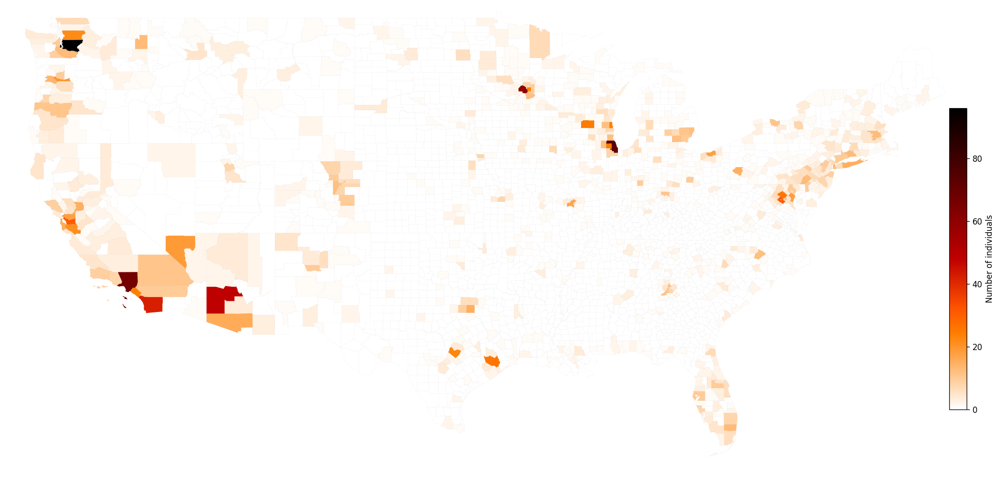

NG_cluster1.1.2


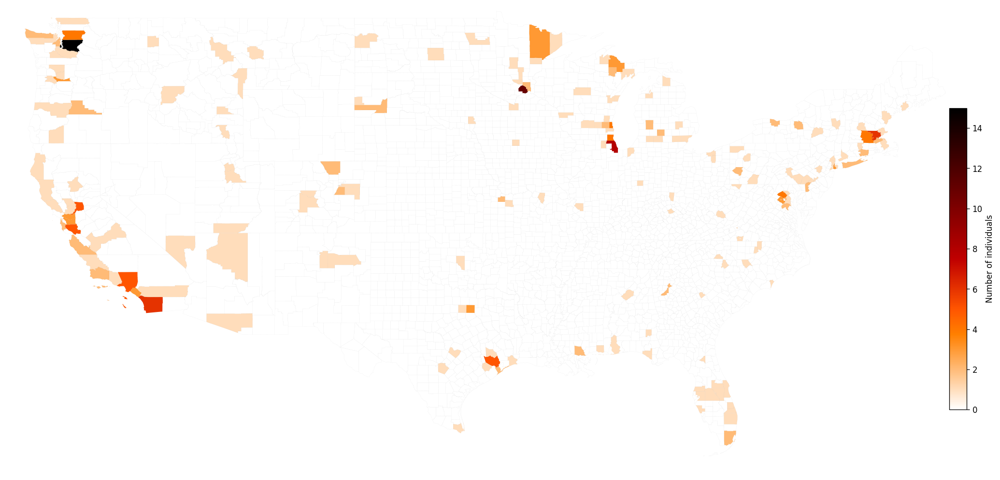

NG_cluster1.1.3


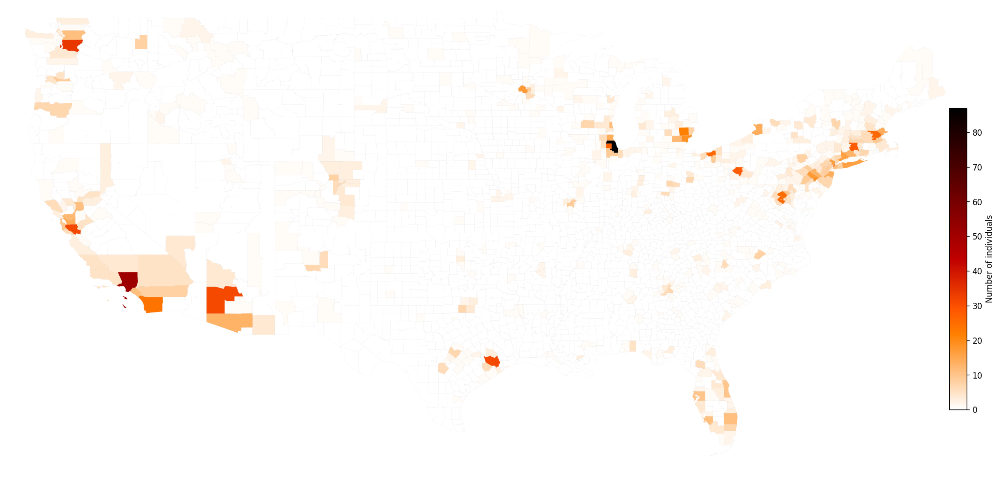

NG_cluster1.1.4


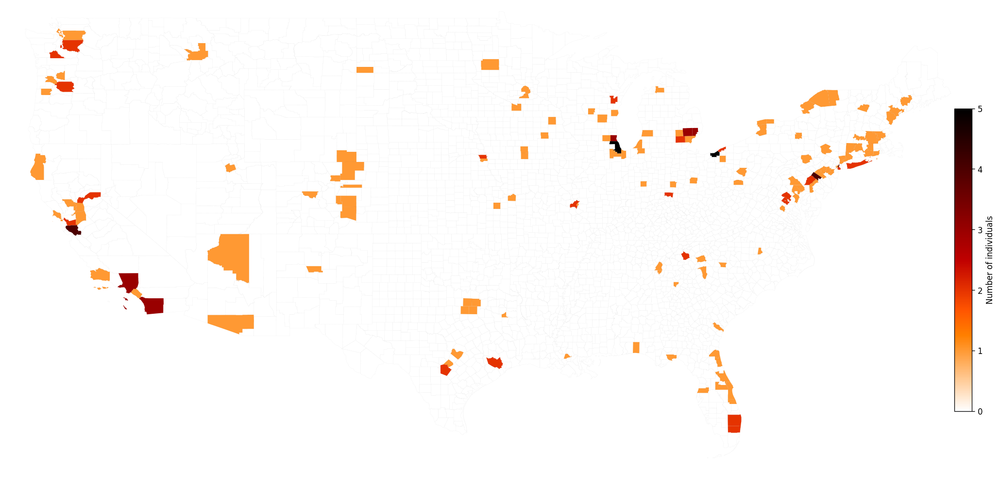

NG_cluster1.2.1


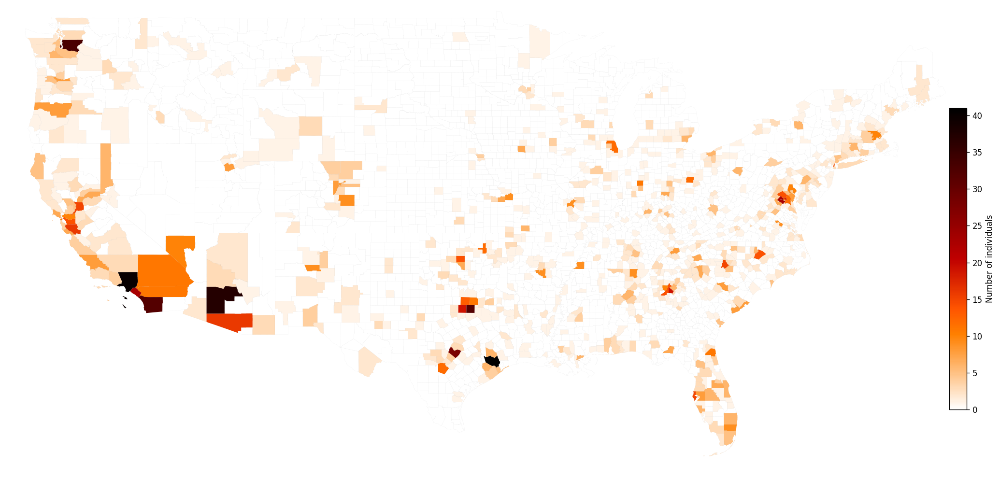

NG_cluster1.2.2


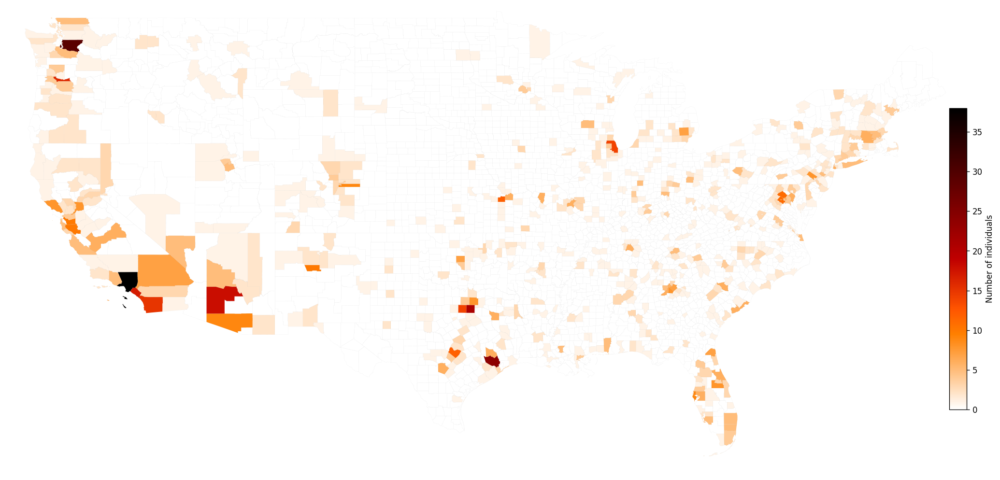

NG_cluster1.2.3


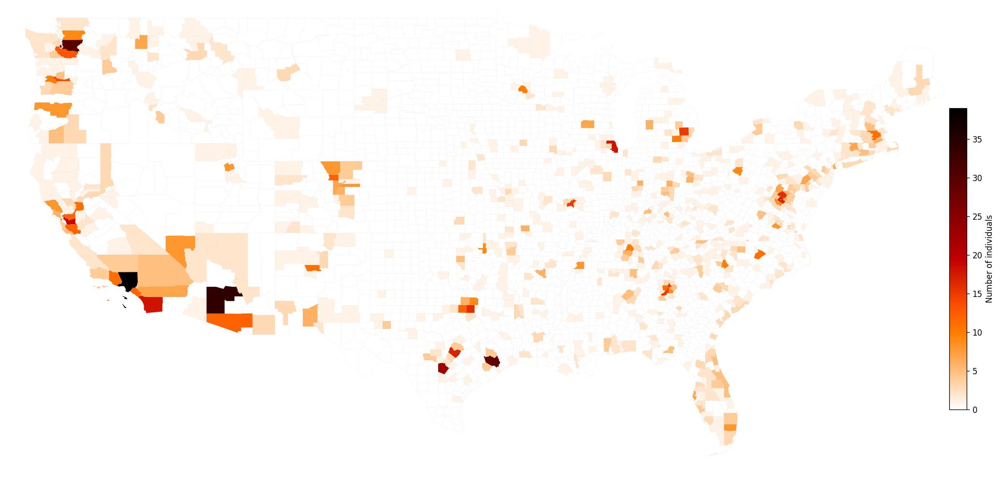

NG_cluster1.2.4


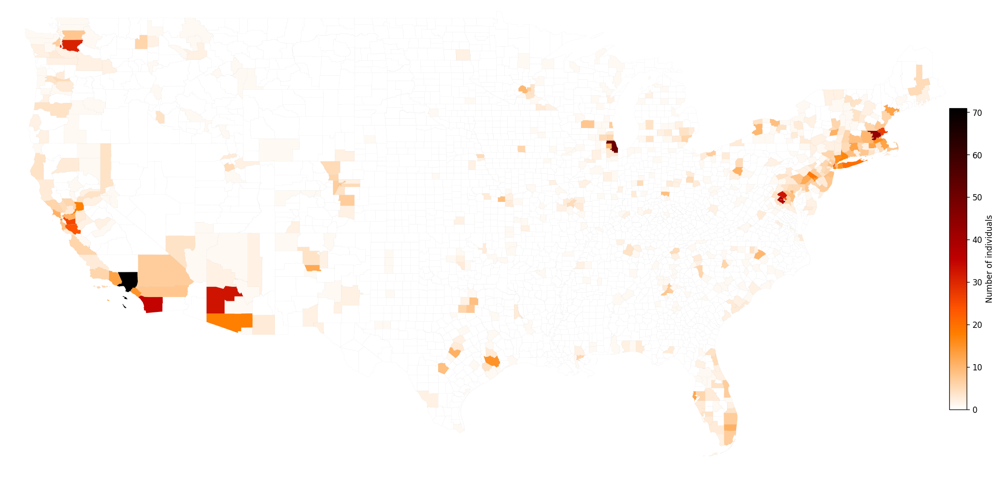

NG_cluster1.2.5


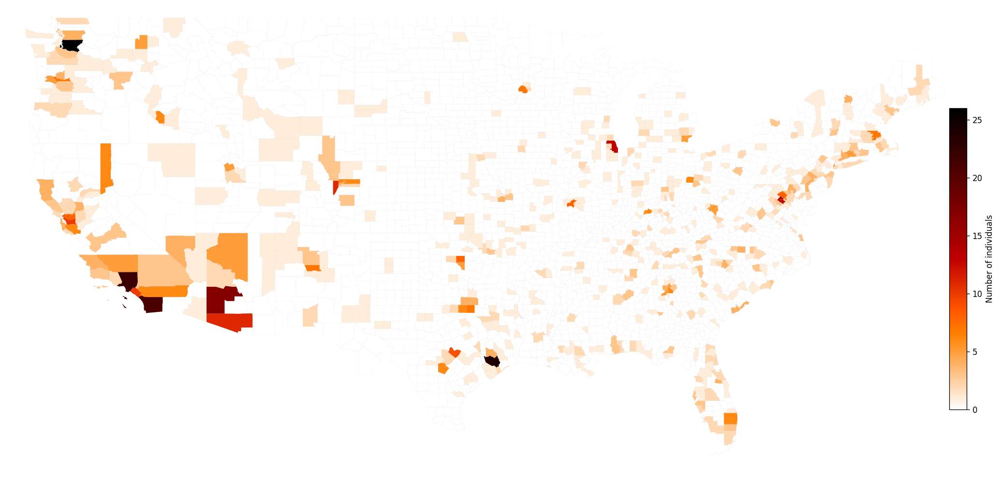

NG_cluster1.2.6


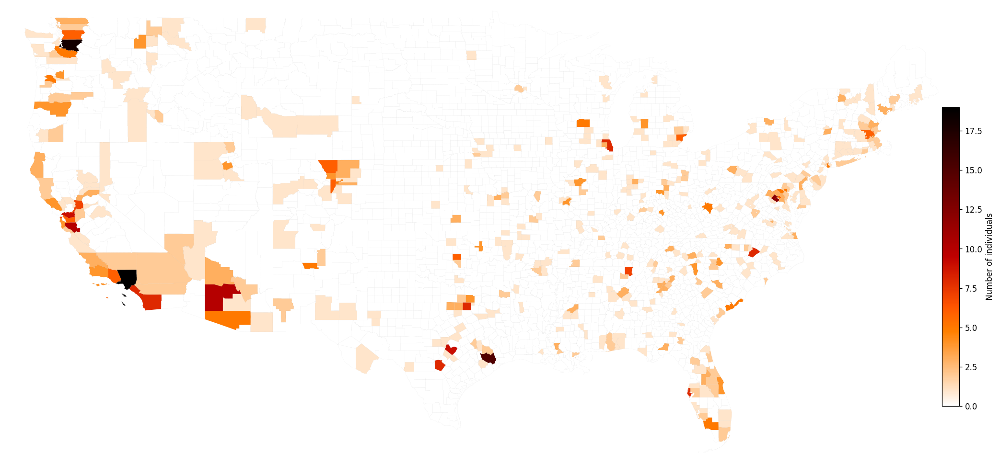

NG_cluster1.3.1


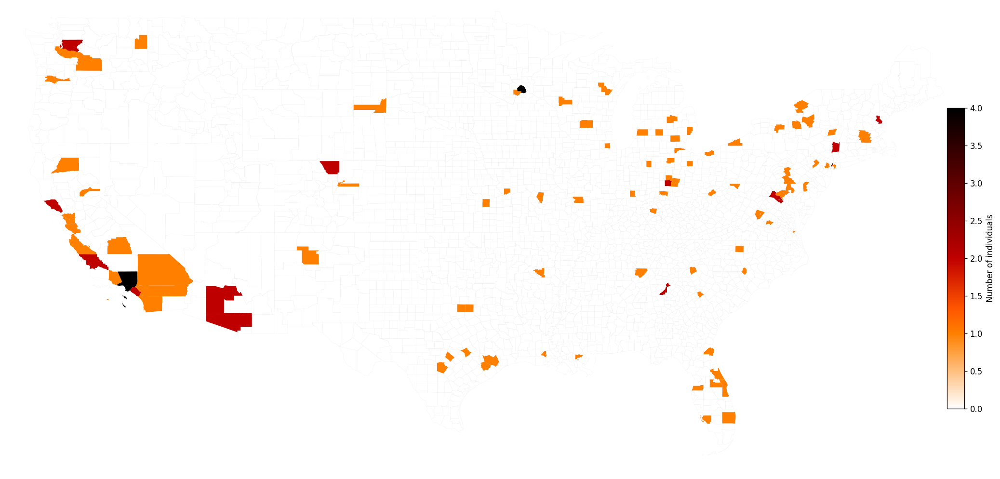

NG_cluster1.3.2


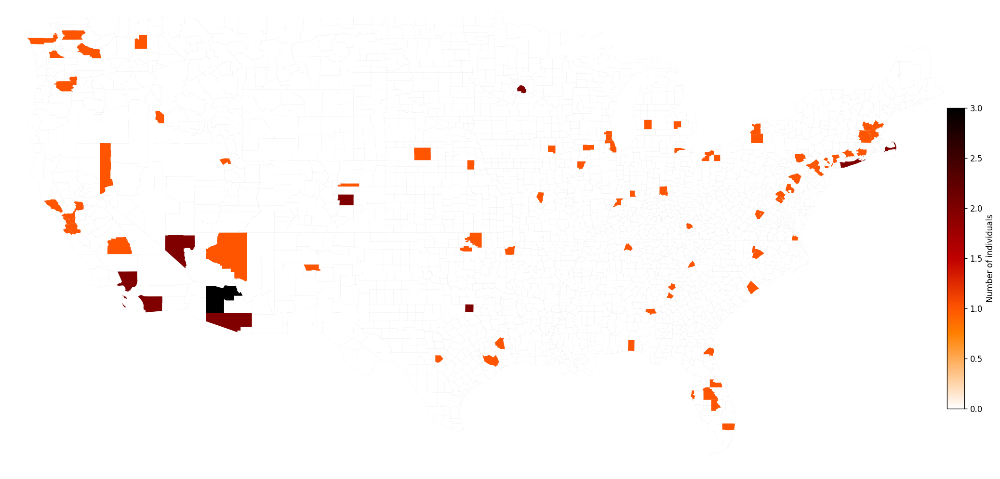

NG_cluster1.3.3


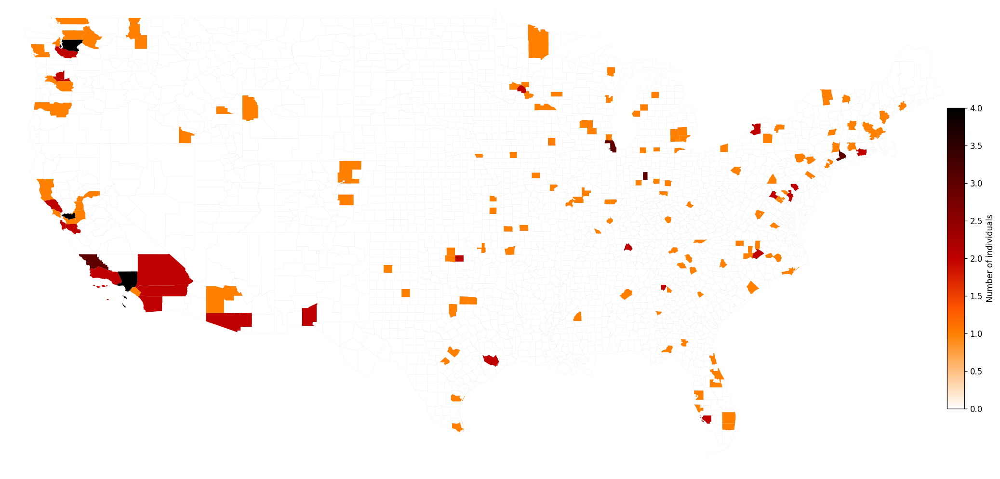

NG_cluster1.3.4


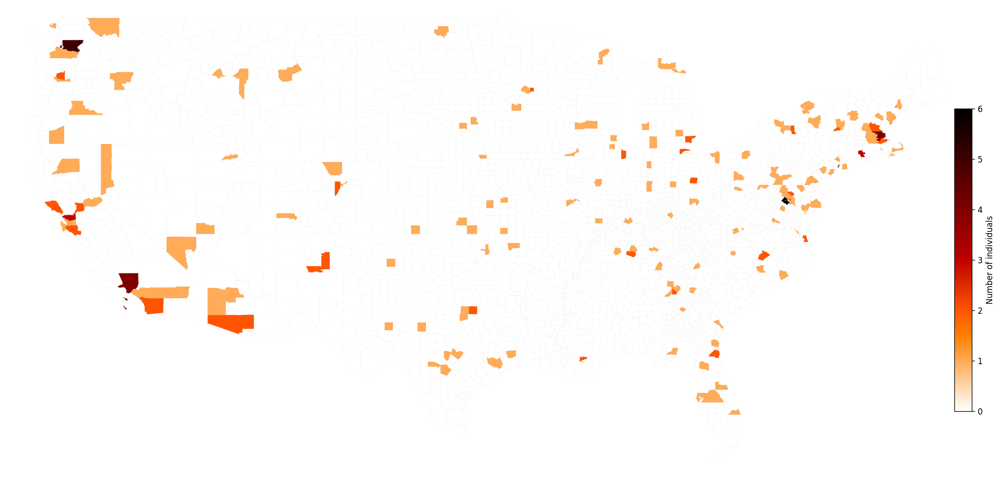

NG_cluster1.4.1


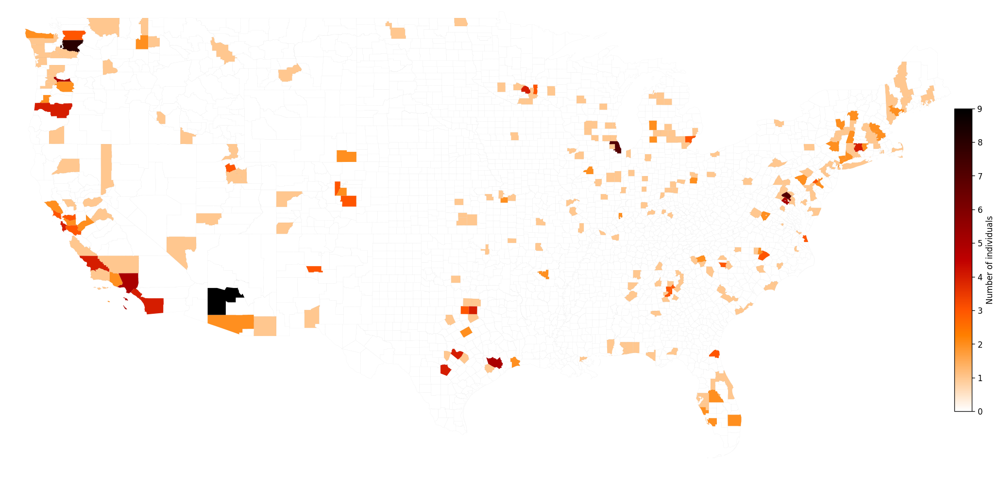

NG_cluster1.4.2


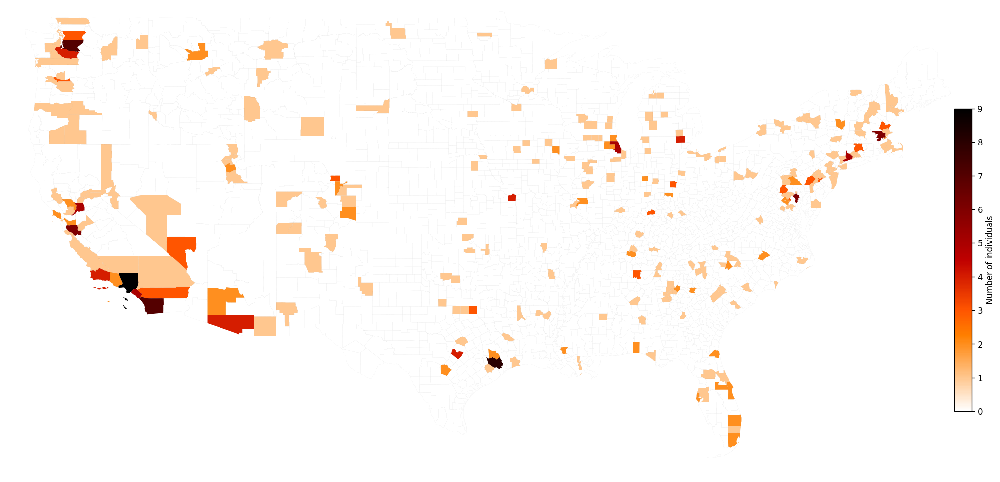

NG_cluster1.4.3


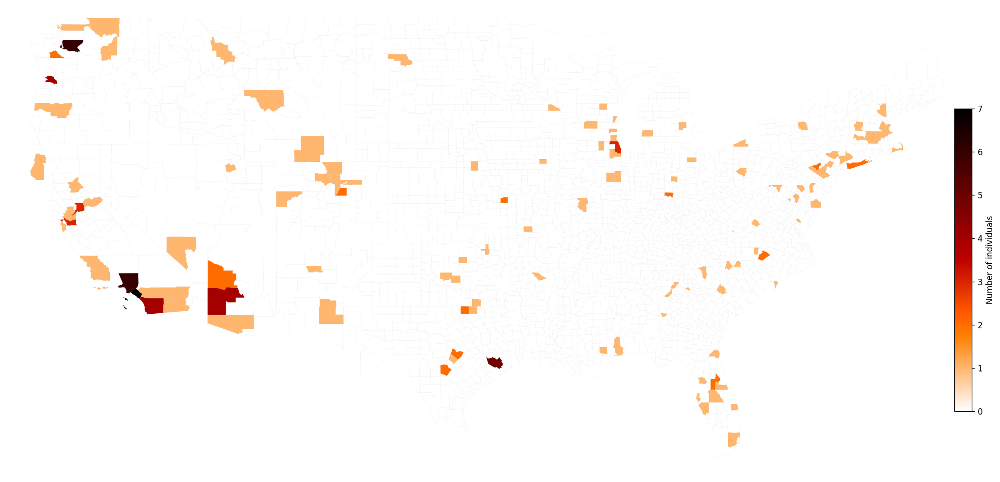

NG_cluster1.5.1


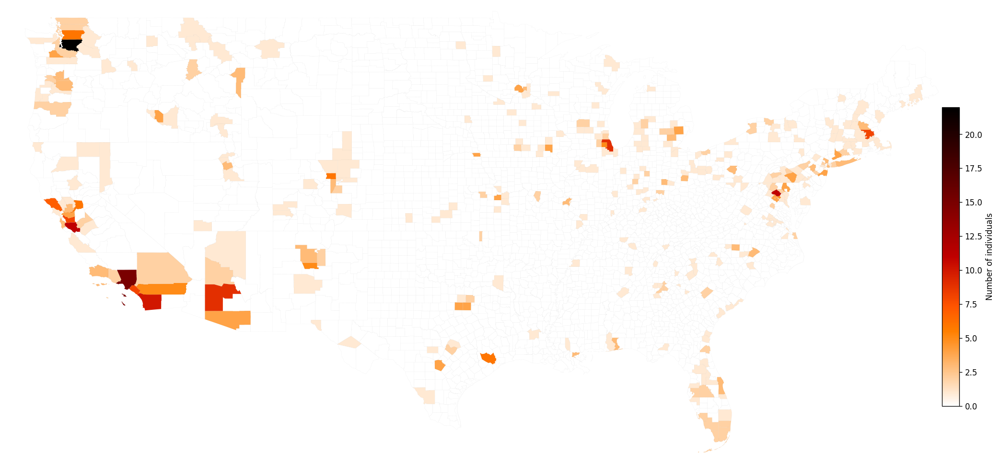

NG_cluster1.5.2


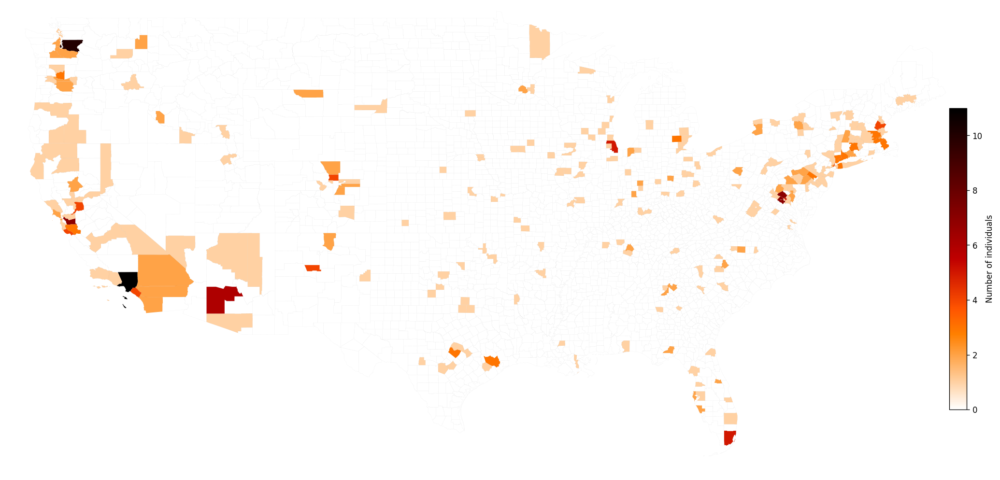

NG_cluster1.5.3


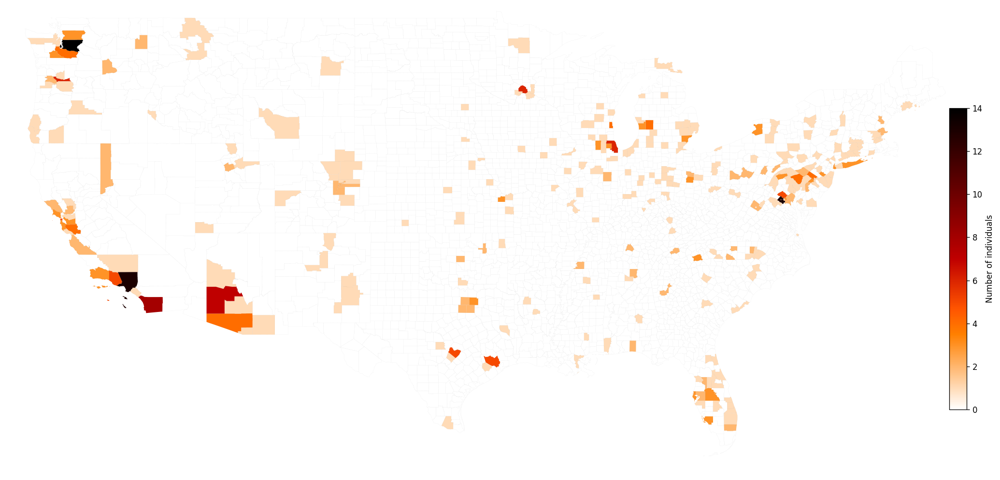

NG_cluster1.5.4


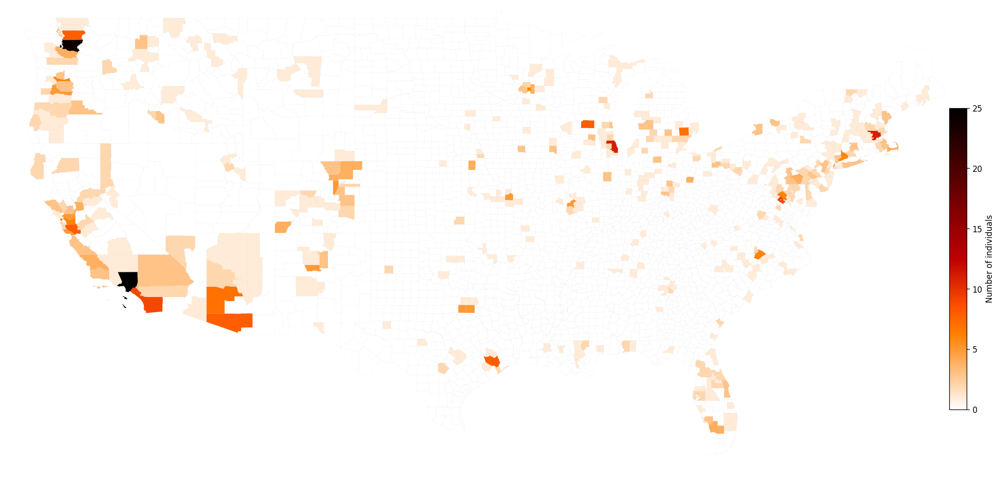

NG_cluster1.5.5


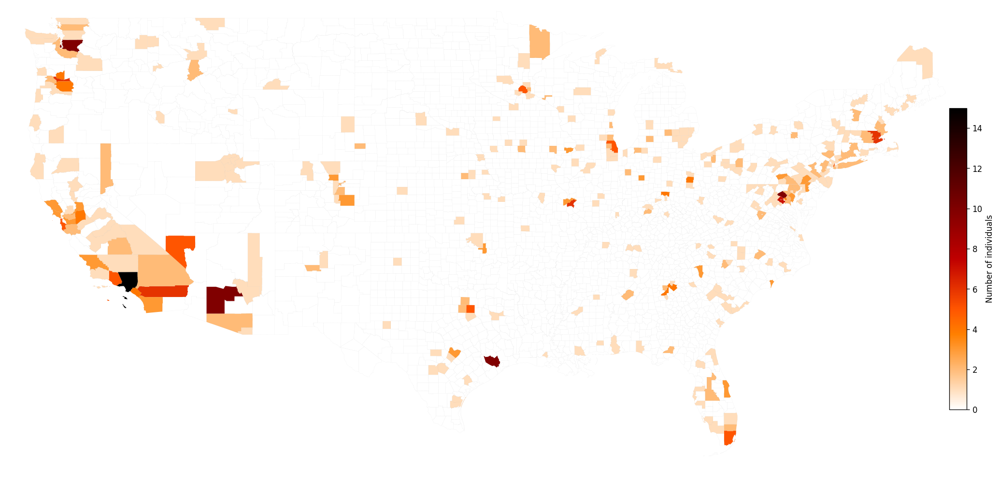

NG_cluster1.5.6


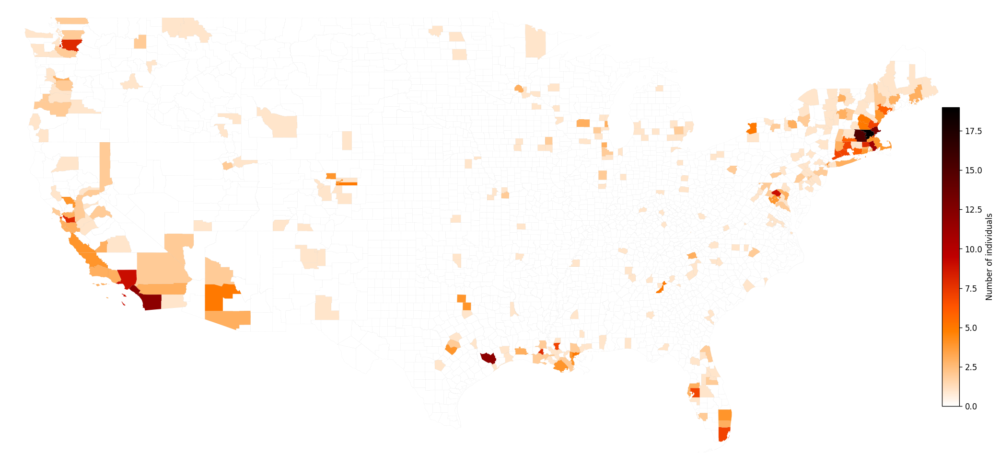

NG_cluster1.6.1


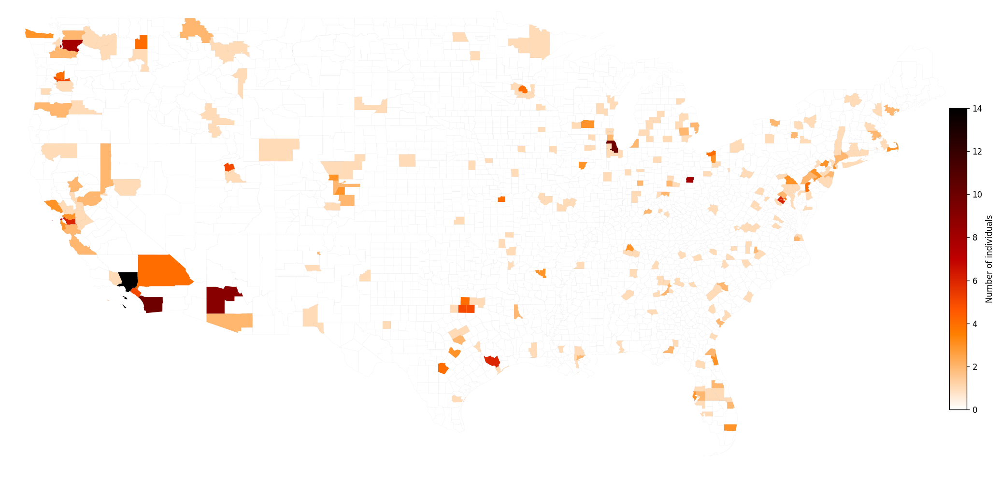

NG_cluster1.6.2


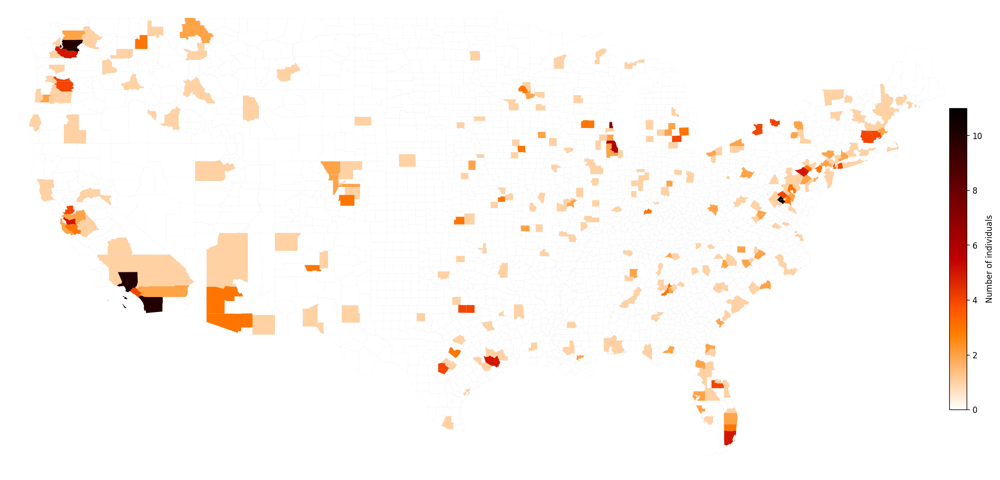

NG_cluster1.6.3


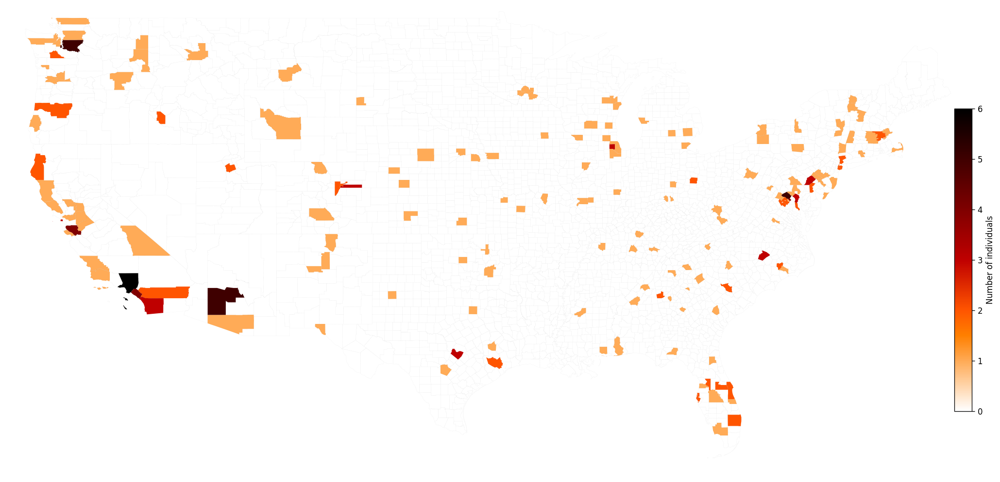

NG_cluster1.6.4


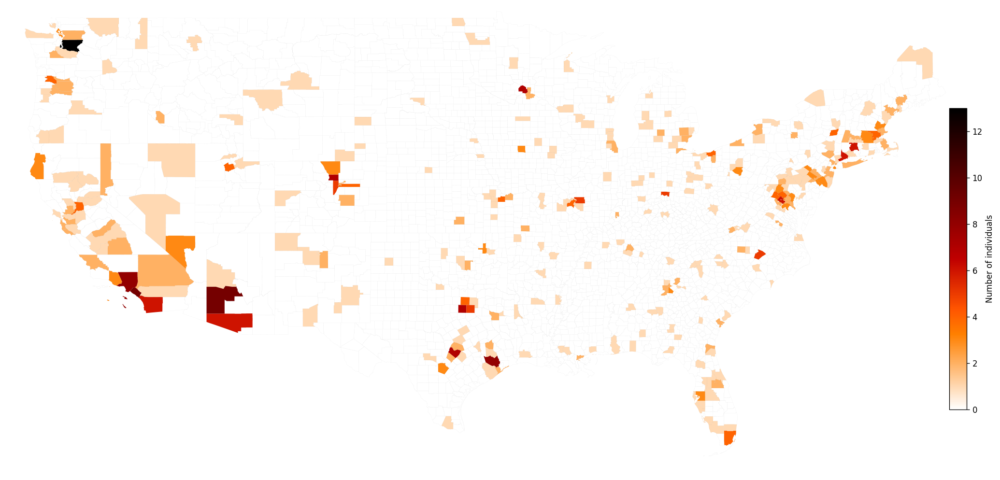

NG_cluster2.1.1


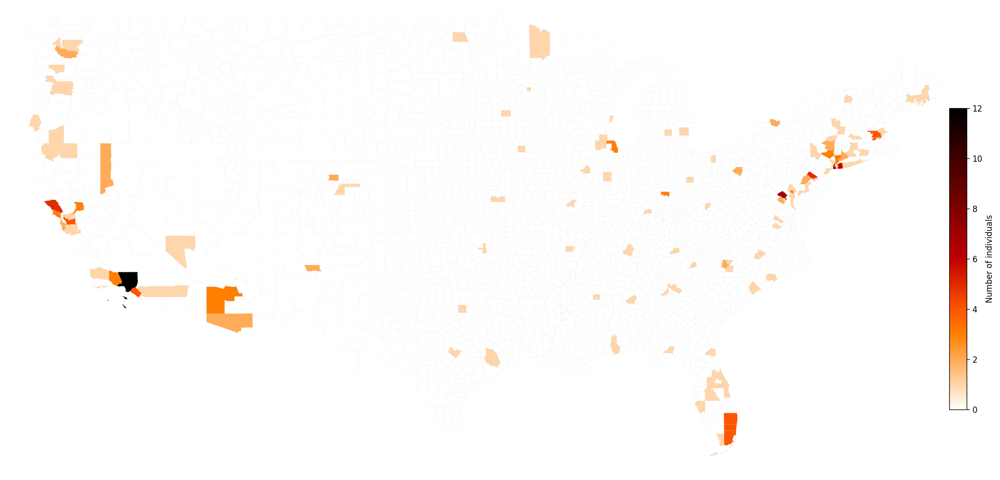

NG_cluster2.1.2


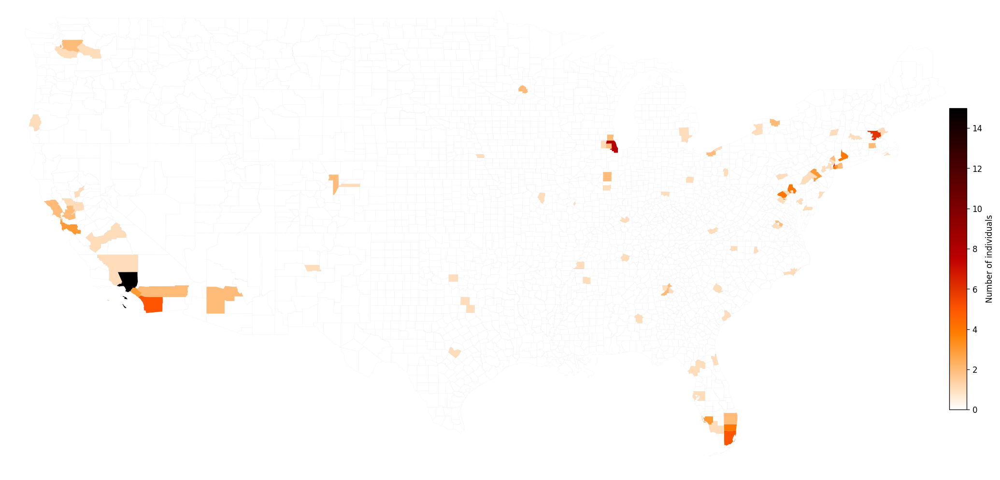

NG_cluster2.1.3


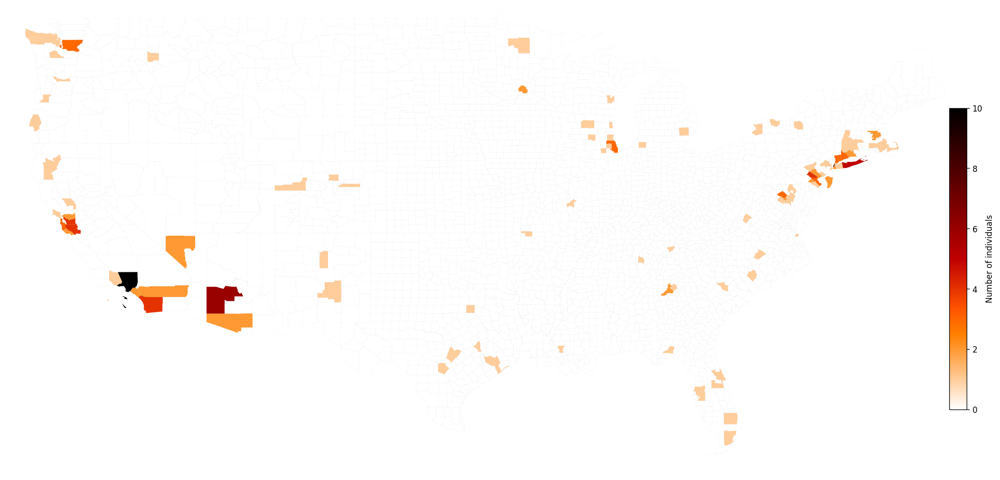

NG_cluster2.1.4


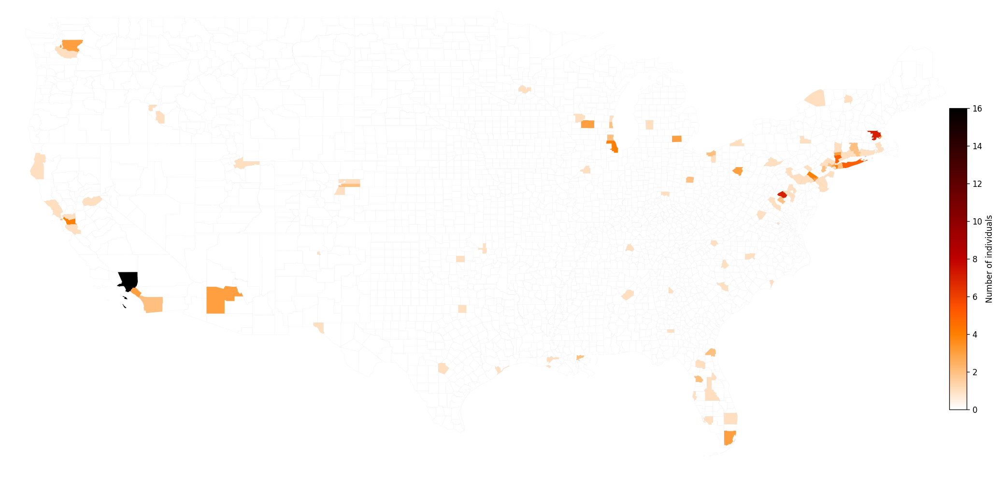

NG_cluster2.1.5


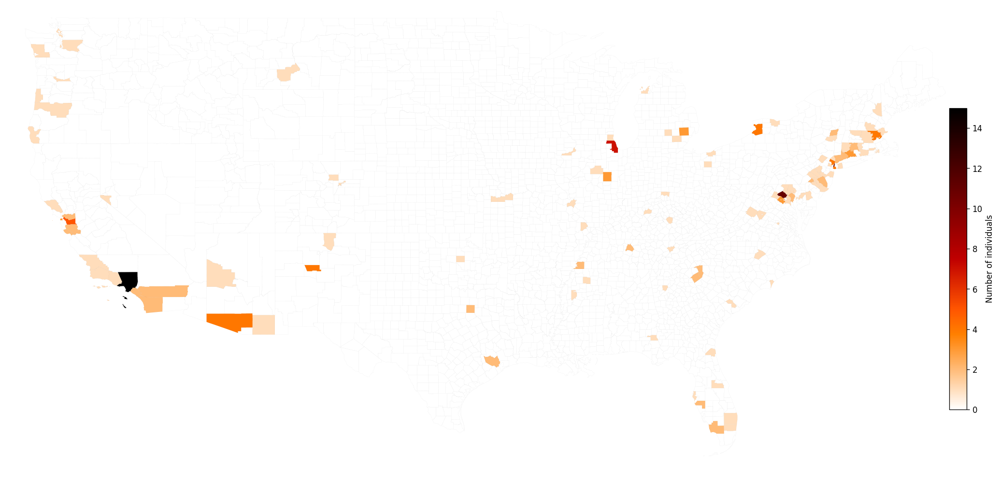

NG_cluster2.1.6


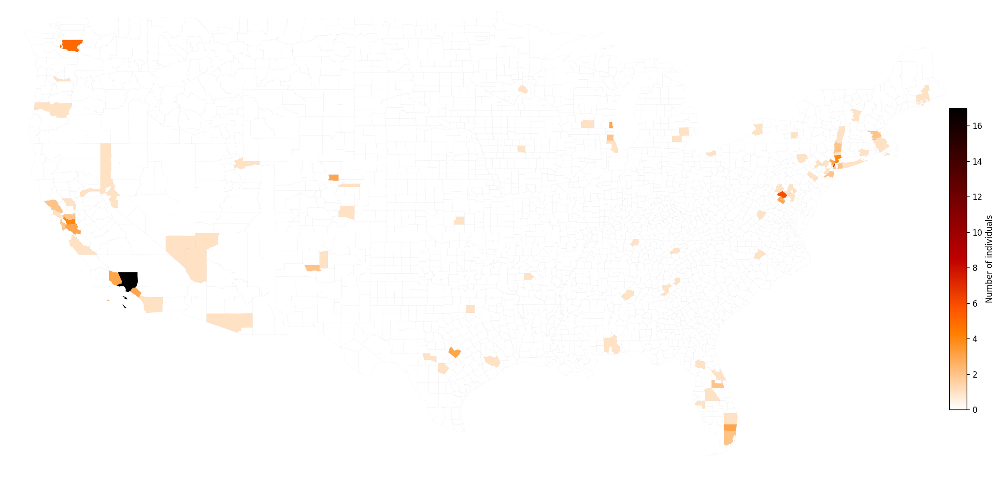

NG_cluster2.1.7


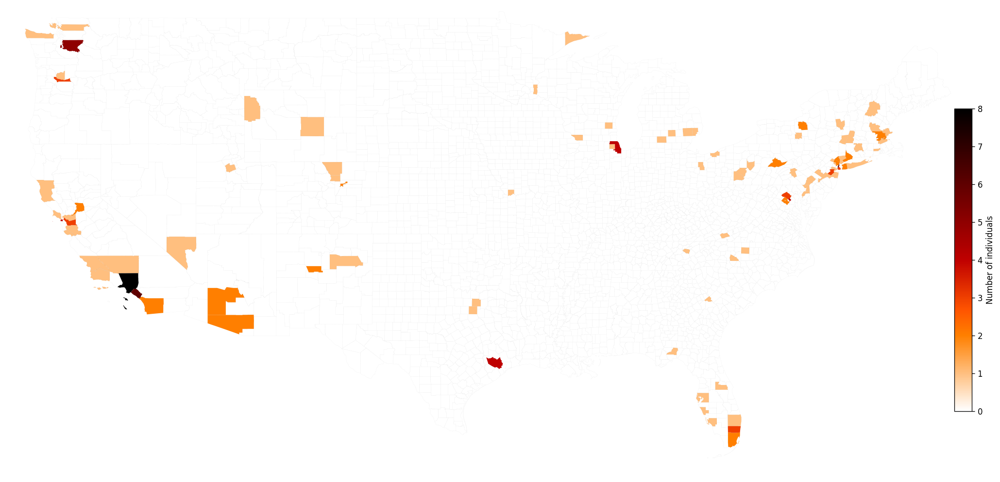

NG_cluster2.1.8


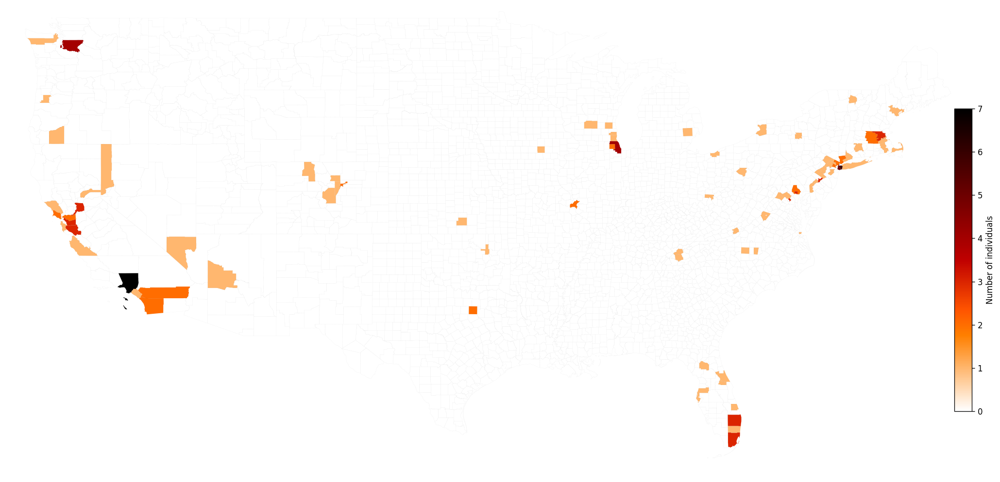

NG_cluster2.2.1


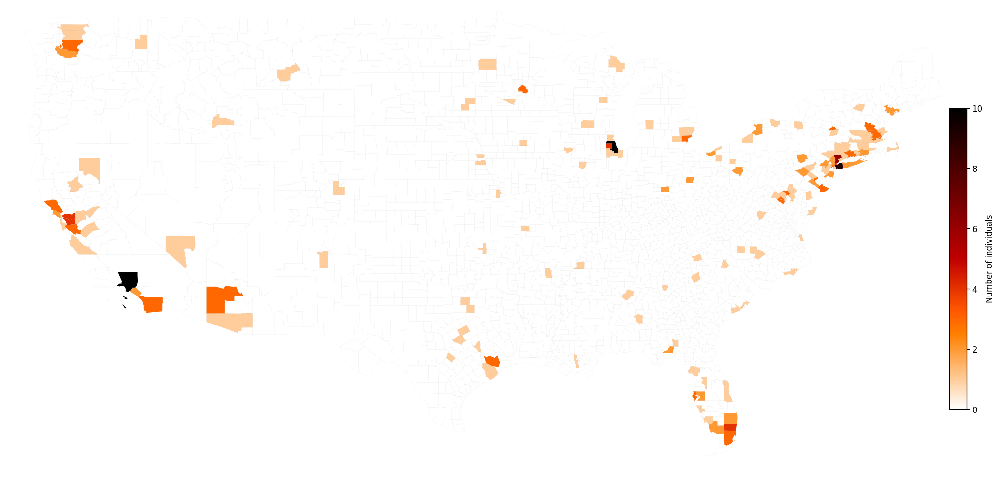

NG_cluster2.2.2


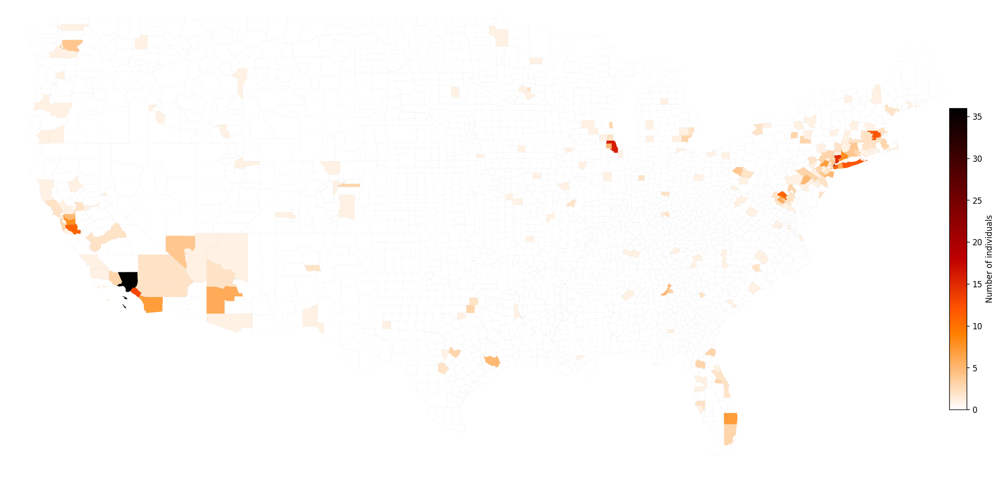

NG_cluster2.2.3


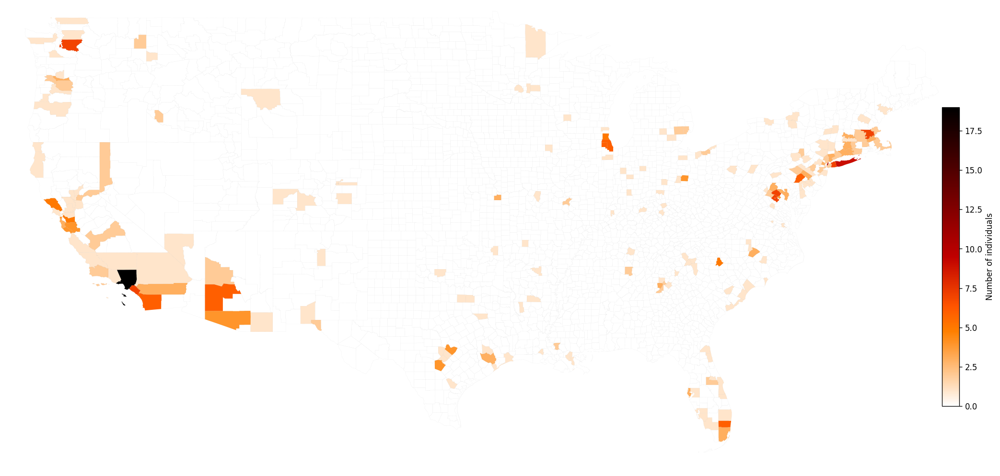

NG_cluster2.2.4


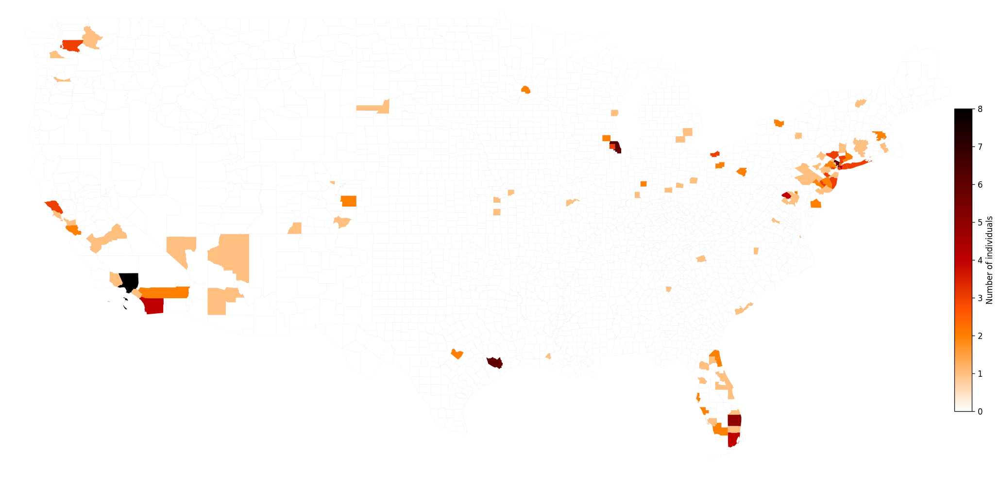

NG_cluster3.1.1


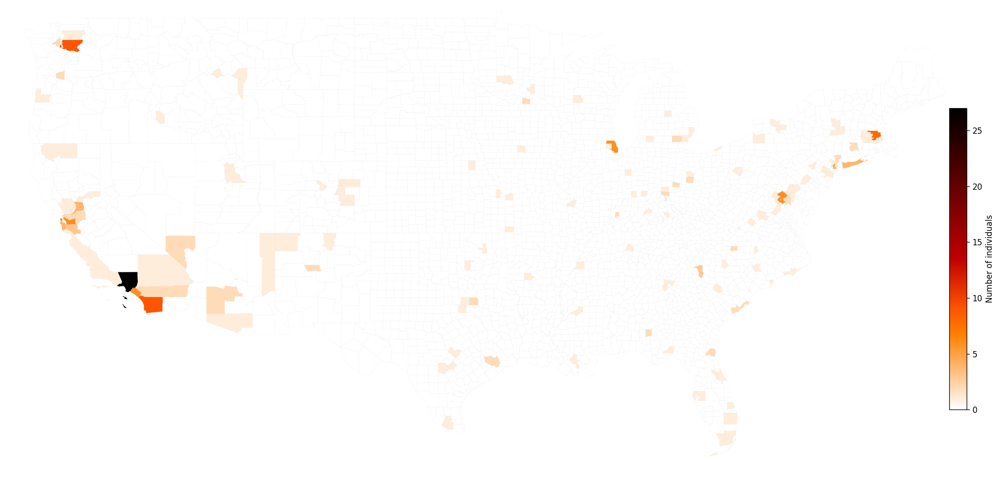

NG_cluster3.1.2


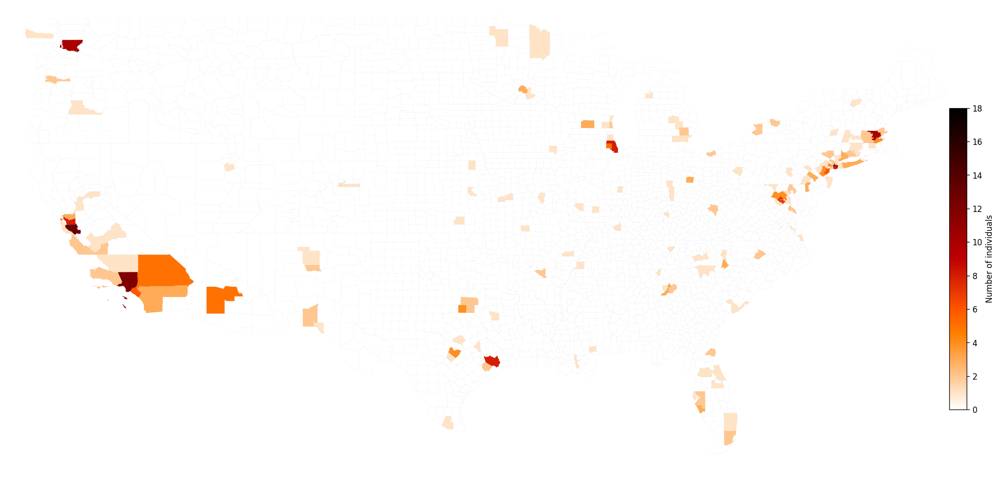

NG_cluster3.1.3


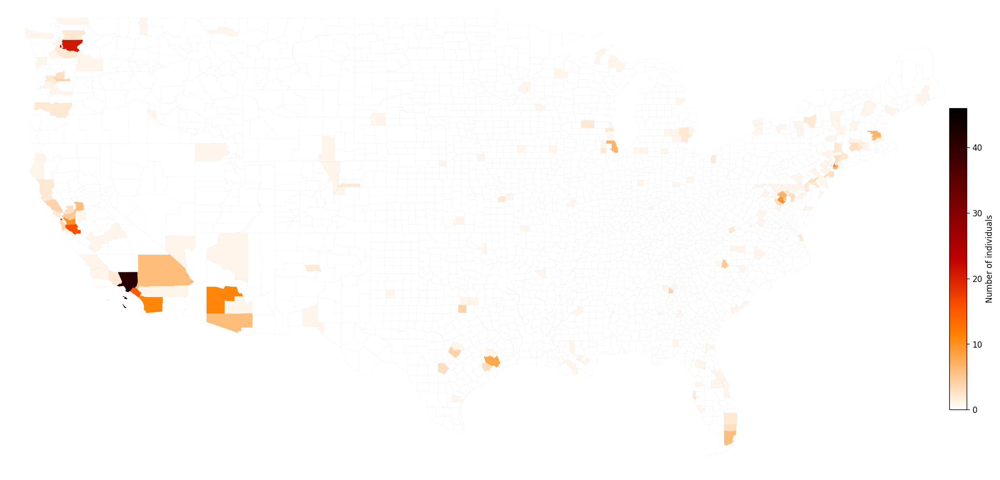

NG_cluster3.2.1


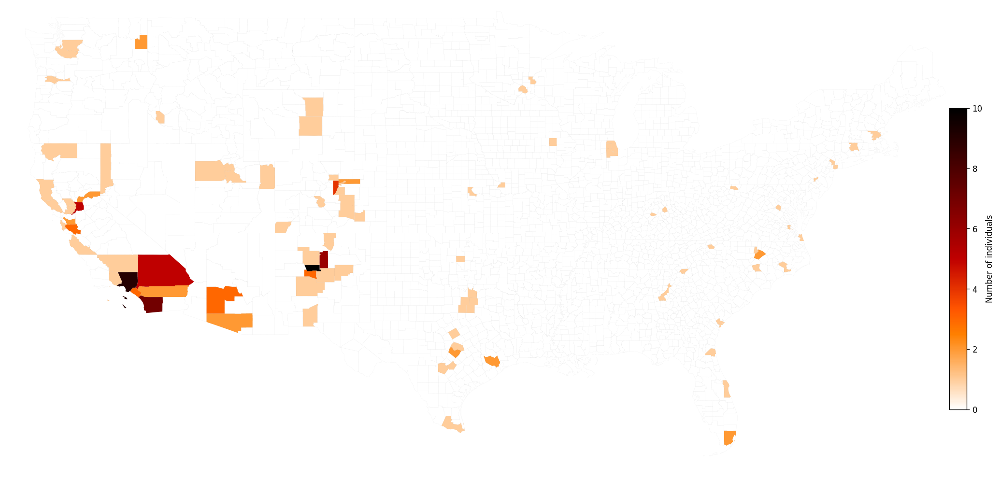

NG_cluster3.2.2


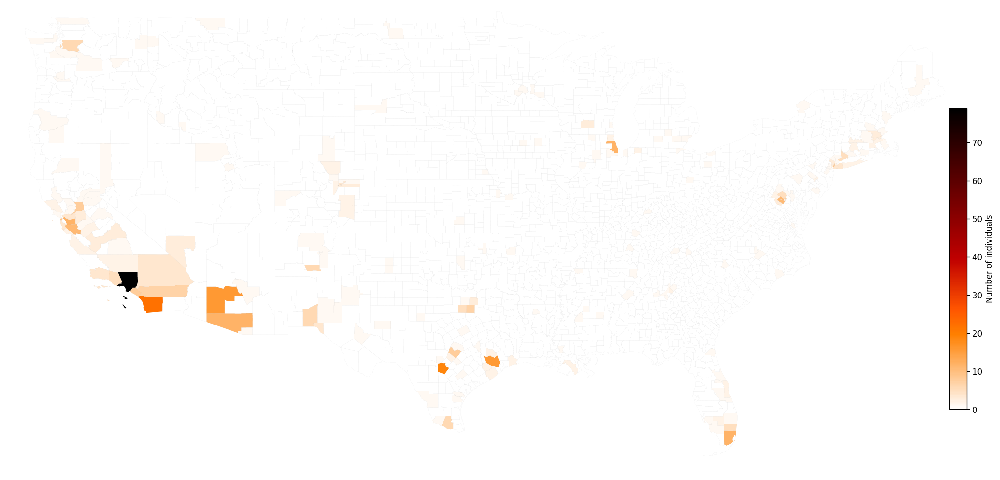

NG_cluster3.2.3


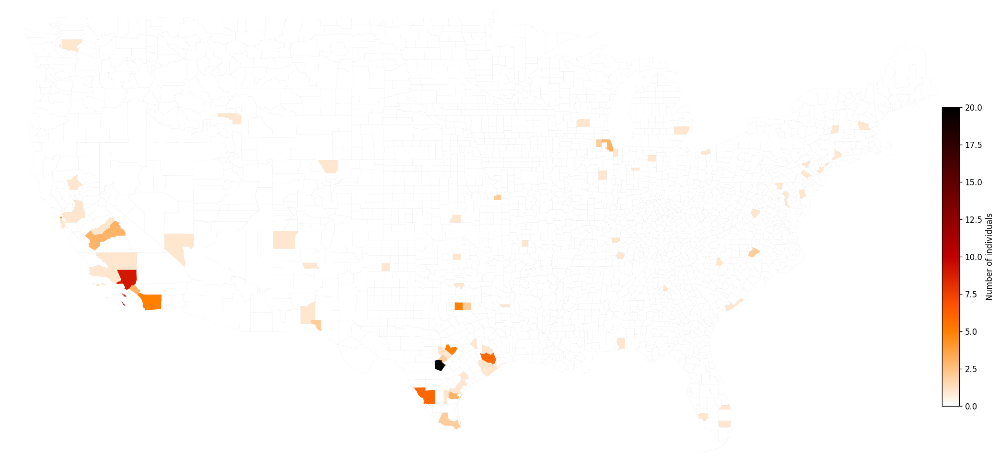

NG_cluster3.2.4


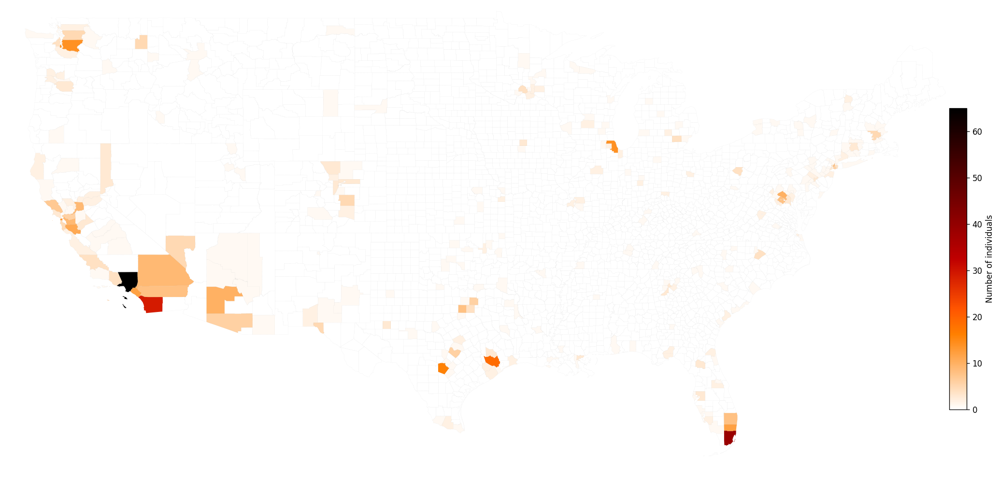

NG_cluster3.3.1


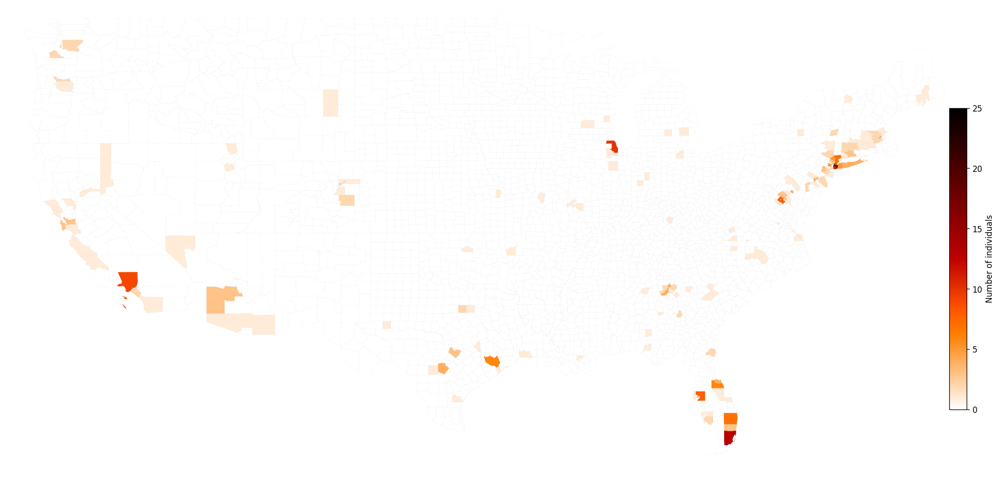

NG_cluster3.3.2


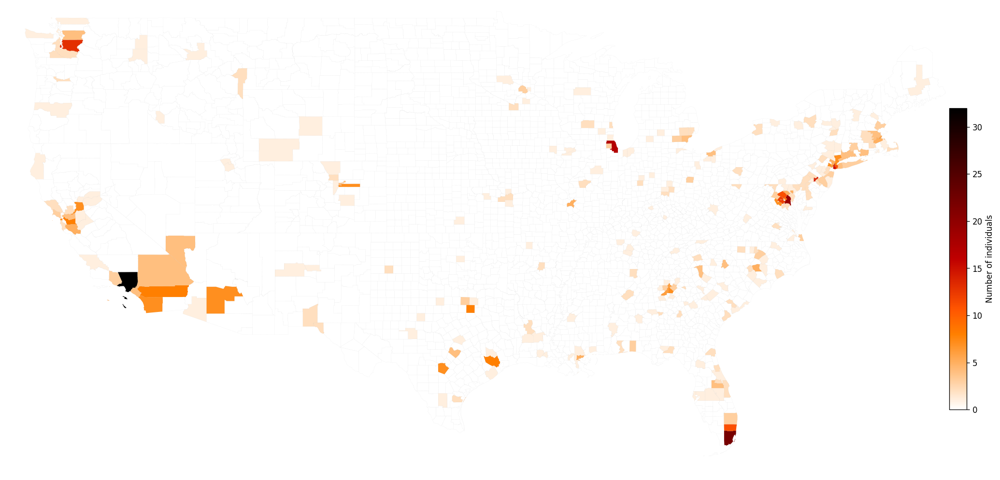

NG_cluster3.3.3


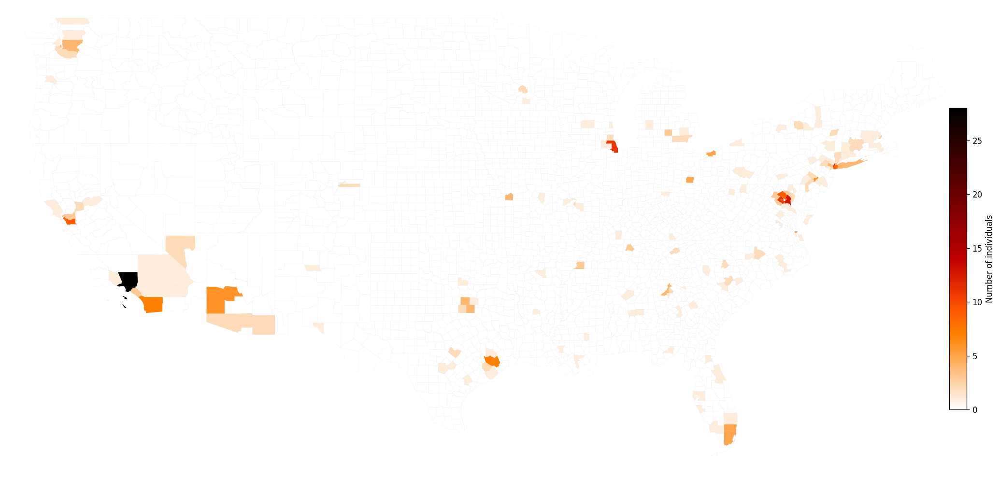

In [4]:
#get NG geolocation data
ng_loc_df = pandas.read_csv('NG_ind_zip_lat_long_fips.txt', sep = '\t', header = None, usecols = [0,1,4])
ng_loc_df.columns = ['NG_ID','zipcode', 'FIPS']
#zipcode_county_fips = pandas.read_table('./county_data/zipcode_county_table.txt', usecols = [0,3])
#ng_loc_df = ng_loc_df.merge(zipcode_county_fips, left_on = 'zipcode', right_on = 'ZCTA5')[['NG_ID','zipcode','FIPS']]
ng_loc_df.set_index('NG_ID', inplace=True)

#Get inds list
ng_clusters = sorted(glob.glob('/home/chengdai/NG/haplotype_analysis/network_analysis/unrelated_network/spectral_embedding/louvain_clusters/level3/NG*'))
for cluster_inds in ng_clusters:
    #ng_inds_list = '~/NG/haplotype_analysis/network_analysis/unrelated_network/spectral_embedding/louvain_clusters/NG_cluster3_sub3.3.txt'
    print cluster_inds.split('/')[-1].split('.txt')[0]
    ng_inds = pandas.read_table(cluster_inds, index_col = 0)
    ng_inds_geotagged = ng_inds.join(ng_loc_df)

    county_count_df = ng_inds_geotagged.groupby('FIPS').count().iloc[:,0]
    county_count_dict = county_count_df.to_dict()

    county_data_folder = '/home/chengdai/NG/figures/us_map/county_data/ascii_files/'
    zipcode_data_folder = '/home/chengdai/NG/figures/us_map/zipcode_data/ascii_files/'

    d_county, county_lon_lat_bounds = combine_states(county_data_folder, 'county')
    #d, lon_lat_bounds = combine_states(zipcode_data_folder, 'zipcode')

    plot_map(d_county, county_count_dict, county_lon_lat_bounds, width = 20)
    #plot_map(d, zipcode_count_dict, lon_lat_bounds, width = 20, color_map = pop_color_map[ancestral_pop], pop_label = ancestral_pop, out_file = './figures/NG_{0}_by_zipcode.png'.format(ancestral_pop))